In [16]:
import pandas as pd 
from uszipcode import SearchEngine
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from shapely.geometry import Point 
import geopandas as gpd 
from shapely.geometry import Point, Polygon
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
import squarify 

pd.set_option('display.max_columns', None)

ModuleNotFoundError: No module named 'pandas.table'

In [2]:
collision_df = pd.read_feather('/Users/emmanuely/Desktop/Homework_Assignments/Spring_2024_Classes/STAT_3255/final-project-BlankSpaceX1/Data/Motor_Vehicle_Collisions_and_Crashes.feather')

In [3]:
collision_df.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,CONTRIBUTING FACTOR VEHICLE 1,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,01/01/2018,4:16,MANHATTAN,10025,40.801800,-73.961080,"(40.8018, -73.96108)",CATHEDRAL PARKWAY,MORNINGSIDE DRIVE,None,1.0,0.0,0,0,0,0,1,0,Other Vehicular,Following Too Closely,None,None,None,3820157,Sedan,Sedan,None,None,None
1,01/01/2018,20:30,QUEENS,11373,40.743973,-73.885100,"(40.743973, -73.8851)",BROADWAY,BAXTER AVENUE,None,0.0,0.0,0,0,0,0,0,0,Unsafe Speed,Failure to Yield Right-of-Way,None,None,None,3818846,Sedan,Sedan,None,None,None
2,01/01/2018,15:30,MANHATTAN,10025,40.801740,-73.964770,"(40.80174, -73.96477)",WEST 108 STREET,AMSTERDAM AVENUE,None,0.0,0.0,0,0,0,0,0,0,Driver Inattention/Distraction,Unspecified,None,None,None,3818947,Sedan,None,None,None,None
3,01/01/2018,12:10,QUEENS,11354,40.763073,-73.816345,"(40.763073, -73.816345)",None,None,40-07 149 STREET,0.0,0.0,0,0,0,0,0,0,Backing Unsafely,Unspecified,None,None,None,3820645,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,None,None,None
4,01/01/2018,18:35,BRONX,10459,40.820305,-73.890830,"(40.820305, -73.89083)",BRUCKNER BOULEVARD,HUNTS POINT AVENUE,None,0.0,0.0,0,0,0,0,0,0,Unspecified,Unspecified,None,None,None,3819261,Station Wagon/Sport Utility Vehicle,Sedan,None,None,None


In [4]:
#Defines chunks of different data wbich are easier to work with
chunk_size = 15000
num_chunks = len(collision_df) // chunk_size + 1  

chunks = [collision_df.iloc[i*chunk_size:(i+1)*chunk_size] for i in range(num_chunks)]

first_chunk = chunks[0]

In [5]:
polygon = Polygon([(0, 0), (0, 2), (2, 2), (2, 0), (0, 0)])
gdf3 = gpd.GeoDataFrame(geometry=[polygon])

geometry = [Point(xy) for xy in zip(first_chunk["LONGITUDE"], first_chunk["LATITUDE"]) if not Point(xy).is_empty]

crs = {'init': 'epsg:4326'}
crash_gdf = gpd.GeoDataFrame(first_chunk.loc[~pd.isna(first_chunk["LONGITUDE"]) & ~pd.isna(first_chunk["LATITUDE"])], 
                              crs=crs, geometry=geometry)

crash_gdf.explore(column='BOROUGH', legend=True, legend_kwds={'labels': {'BRONX': 'Red', 'BROOKLYN': 'Blue',
                                                                         'MANHATTAN': 'Green', "QUEENS":'Brown', 
                                                                         "STATEN ISLAND": 'Yellow'}})


## Examining Hotspots

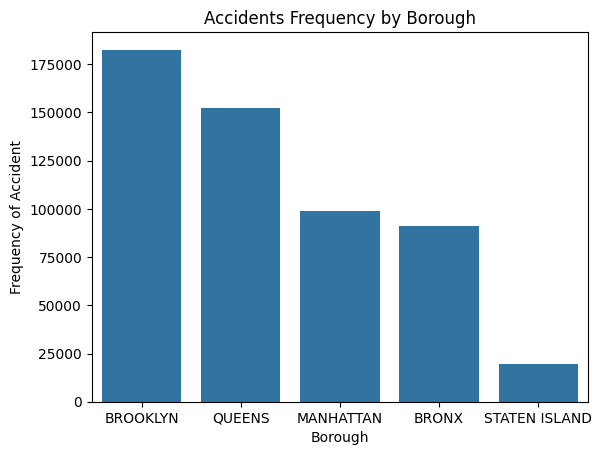

In [4]:
borough_accidents = collision_df['BOROUGH'].value_counts()
borough_accidents_df = pd.DataFrame({'Borough': borough_accidents.index, 
                                     'Frequency of Accident': borough_accidents.values})

sns.barplot(data=borough_accidents_df, x="Borough", y="Frequency of Accident")
plt.xlabel("Borough")
plt.ylabel("Frequency of Accident")
plt.title("Accidents Frequency by Borough")
plt.show()

In [7]:
lst_of_boroughs = collision_df['BOROUGH'].unique()

lst_cyclists_injured = []
lst_pedestrians_injured = []
lst_motorists_injured = []

for borough in lst_of_boroughs:
    cyclists_injured = len(collision_df[(collision_df['BOROUGH'] == borough) & (collision_df['NUMBER OF CYCLIST INJURED'] >= 1)])
    lst_cyclists_injured.append(cyclists_injured)
    
    pedestrians_injured = len(collision_df[(collision_df['BOROUGH'] == borough) & (collision_df['NUMBER OF PEDESTRIANS INJURED'] >= 1)])
    lst_pedestrians_injured.append(pedestrians_injured)

    motorists_injured = len(collision_df[(collision_df['BOROUGH'] == borough) & (collision_df['NUMBER OF MOTORIST INJURED'] >= 1)])
    lst_motorists_injured.append(motorists_injured)


In [8]:
incident_types = pd.DataFrame({'Cyclists Injured': lst_cyclists_injured, 'Pedestrians Injured': lst_pedestrians_injured,
                               'Motorists Injured': lst_motorists_injured},
                               index=lst_of_boroughs)

In [9]:
incident_types

,Cyclists Injured,Pedestrians Injured,Motorists Injured
MANHATTAN,6194,6827,9729
QUEENS,4155,8373,26527
BRONX,2432,5609,15521
BROOKLYN,8345,11261,30264
STATEN ISLAND,264,856,4002


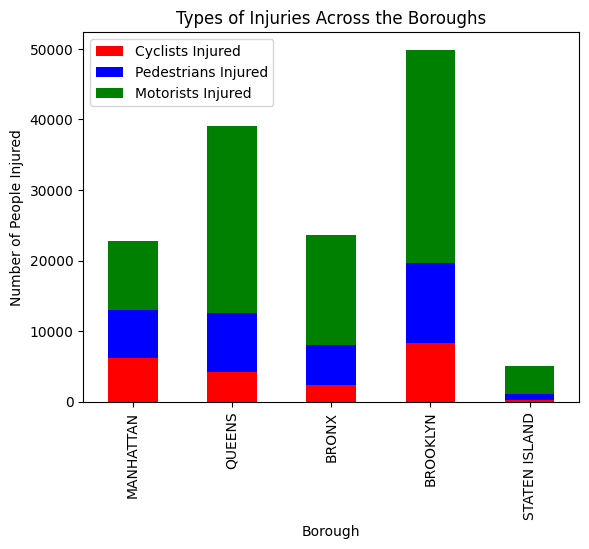

In [10]:
incident_types.plot(kind='bar', stacked=True, color=['red', 'blue', 'green'])
plt.title('Types of Injuries Across the Boroughs')
plt.xlabel('Borough')
plt.ylabel('Number of People Injured')
plt.show()

Brooklyn appears to be the borough with the highest amount of crashes, so let's focus more closely on this borough.

In [7]:
crashes_in_brooklyn = collision_df[collision_df['BOROUGH'] == 'BROOKLYN']

In [8]:
crashes_in_brooklyn.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,CONTRIBUTING FACTOR VEHICLE 1,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
5,01/01/2018,13:50,BROOKLYN,11207,40.658920,-73.889824,"(40.65892, -73.889824)",NEW JERSEY AVENUE,LINDEN BOULEVARD,None,0.0,0.0,0,0,0,0,0,0,Unspecified,Unspecified,None,None,None,3820853,Sedan,None,None,None,None
6,01/01/2018,1:37,BROOKLYN,11212,40.662277,-73.910780,"(40.662277, -73.91078)",LIVONIA AVENUE,BRISTOL STREET,None,0.0,0.0,0,0,0,0,0,0,Backing Unsafely,Unspecified,None,None,None,3819256,Sedan,Sedan,None,None,None
10,01/01/2018,5:00,BROOKLYN,11229,40.604576,-73.938220,"(40.604576, -73.93822)",None,None,2024 GERRITSEN AVENUE,0.0,0.0,0,0,0,0,0,0,Driver Inattention/Distraction,Unspecified,None,None,None,3820673,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,None,None,None
14,01/01/2018,22:40,BROOKLYN,11212,40.661907,-73.927574,"(40.661907, -73.927574)",RUTLAND ROAD,EAST 92 STREET,None,0.0,0.0,0,0,0,0,0,0,Passing or Lane Usage Improper,Unspecified,None,None,None,3821039,Sedan,Sedan,None,None,None
15,01/01/2018,2:30,BROOKLYN,11237,40.699190,-73.914690,"(40.69919, -73.91469)",MYRTLE AVENUE,IRVING AVENUE,None,0.0,0.0,0,0,0,0,0,0,Pavement Slippery,Unspecified,None,None,None,3820937,Sedan,Sedan,None,None,None


In [18]:
hue_chunk = crashes_in_brooklyn.head(50)

In [21]:
hue_chunk.to_excel('why.xlsx')

For this disaster of a borough, let's do some further visual analysis before we do some machine learning. When are most of the crashes occurring?

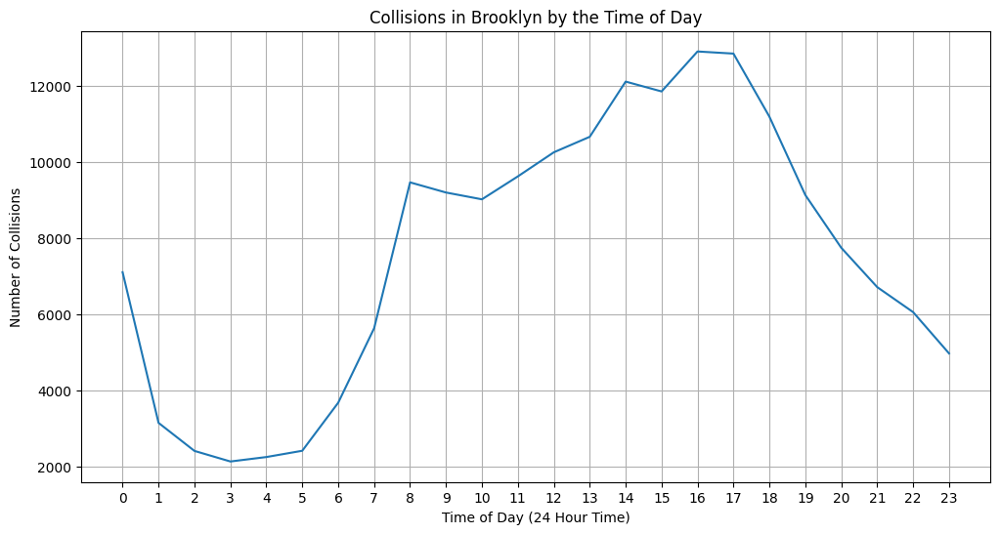

In [25]:
crashes_in_brooklyn['CRASH TIME'] = pd.to_datetime(crashes_in_brooklyn['CRASH TIME'])

collisions_by_time = crashes_in_brooklyn.groupby(crashes_in_brooklyn['CRASH TIME'].dt.hour).size()


plt.figure(figsize=(12, 6))
plt.plot(collisions_by_time.index, collisions_by_time.values)
plt.title('Collisions in Brooklyn by the Time of Day')
plt.xlabel('Time of Day (24 Hour Time)')
plt.ylabel('Number of Collisions')
plt.xticks(range(24))  
plt.grid(True)  

plt.savefig('collisions_by_time_plot.jpeg', bbox_inches='tight', pad_inches=0.5)
plt.show()

Further with the zipcodes

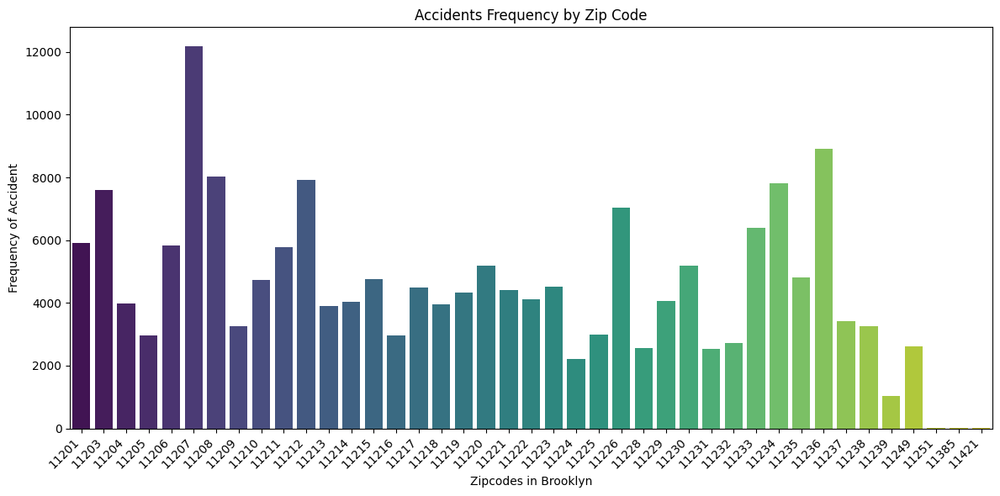

In [26]:
brooklyn_accidents = crashes_in_brooklyn['ZIP CODE'].value_counts()
brooklyn_accidents_df = pd.DataFrame({'Zip Code': brooklyn_accidents.index, 
                                     'Frequency of Accident': brooklyn_accidents.values})

plt.figure(figsize=(12, 6))

sns.barplot(data=brooklyn_accidents_df, x="Zip Code", y="Frequency of Accident", palette='viridis')
plt.xlabel("Zipcodes in Brooklyn")
plt.ylabel("Frequency of Accident")
plt.title("Accidents Frequency by Zip Code")
plt.xticks(rotation=45, ha='right')  
plt.tight_layout()

plt.savefig('collisions_by_zipcode_plot.jpeg', bbox_inches='tight', pad_inches=0.5)
plt.show()

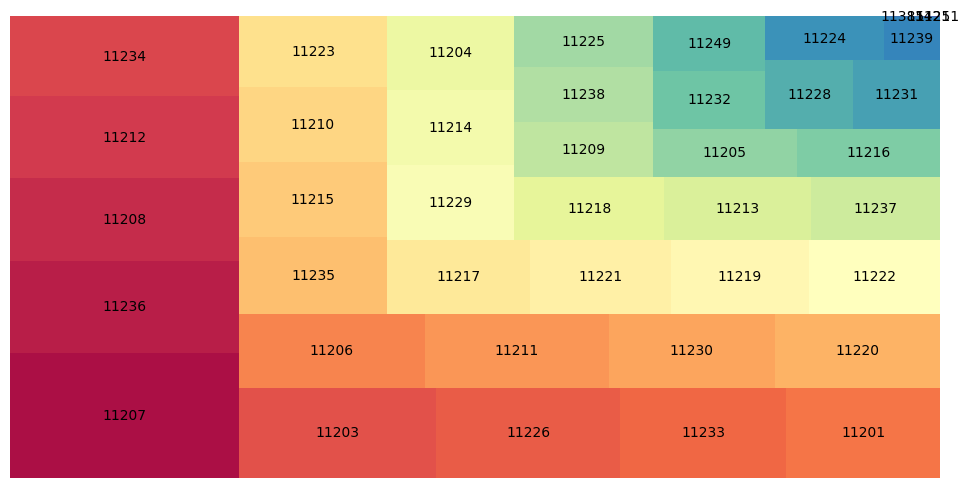

In [28]:
plt.figure(figsize=(12, 6))

squarify.plot(sizes=brooklyn_accidents_df['Frequency of Accident'],
              label=brooklyn_accidents_df['Zip Code'],  
              color=sns.color_palette("Spectral",  
                                     len(brooklyn_accidents_df['Frequency of Accident']))) 
plt.axis("off") 

plt.savefig('collisions_by_zipcode_boxs.jpeg', bbox_inches='tight', pad_inches=0.5)
plt.show()

Seems like zip 11207 is a real issue.

In [31]:
zipcode_11207 = collision_df[(collision_df['BOROUGH'] == 'BROOKLYN') & (collision_df['ZIP CODE'] == 11207)]

In [17]:
zipcode_11207

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,CONTRIBUTING FACTOR VEHICLE 1,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
5,01/01/2018,13:50,BROOKLYN,11207,40.658920,-73.889824,"(40.65892, -73.889824)",NEW JERSEY AVENUE,LINDEN BOULEVARD,None,0.0,0.0,0,0,0,0,0,0,Unspecified,Unspecified,None,None,None,3820853,Sedan,None,None,None,None
40,01/01/2018,7:51,BROOKLYN,11207,40.675632,-73.898780,"(40.675632, -73.89878)",ATLANTIC AVENUE,GEORGIA AVENUE,None,0.0,0.0,0,0,0,0,0,0,Unspecified,Unspecified,None,None,None,3820850,Sedan,Station Wagon/Sport Utility Vehicle,None,None,None
70,01/01/2018,18:20,BROOKLYN,11207,40.680664,-73.902626,"(40.680664, -73.902626)",CONWAY STREET,BUSHWICK AVENUE,None,1.0,0.0,0,0,0,0,1,0,Driver Inattention/Distraction,Unspecified,Unspecified,None,None,3820863,Station Wagon/Sport Utility Vehicle,Sedan,Sedan,None,None
109,01/01/2018,22:30,BROOKLYN,11207,40.659930,-73.891655,"(40.65993, -73.891655)",PENNSYLVANIA AVENUE,HEGEMAN AVENUE,None,0.0,0.0,0,0,0,0,0,0,Driver Inexperience,Unspecified,None,None,None,3820864,Station Wagon/Sport Utility Vehicle,Sedan,None,None,None
128,01/01/2018,21:48,BROOKLYN,11207,40.657753,-73.896120,"(40.657753, -73.89612)",LINDEN BOULEVARD,WILLIAMS AVENUE,None,0.0,0.0,0,0,0,0,0,0,Following Too Closely,Unspecified,None,None,None,3820865,Sedan,Station Wagon/Sport Utility Vehicle,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
544011,01/01/2024,5:00,BROOKLYN,11207,40.656116,-73.896660,"(40.656116, -73.89666)",DE WITT AVENUE,HINSDALE STREET,None,1.0,0.0,0,0,1,0,0,0,Driver Inattention/Distraction,Unspecified,None,None,None,4691778,Bike,None,None,None,None
544021,01/01/2024,0:50,BROOKLYN,11207,40.659450,-73.898470,"(40.65945, -73.89847)",NEW LOTS AVENUE,SNEDIKER AVENUE,None,0.0,0.0,0,0,0,0,0,0,Driver Inattention/Distraction,Unspecified,None,None,None,4692080,TRAILER,Sedan,None,None,None
544029,01/01/2024,4:40,BROOKLYN,11207,40.678757,-73.892800,"(40.678757, -73.8928)",None,None,107 MILLER AVENUE,0.0,0.0,0,0,0,0,0,0,Alcohol Involvement,Unspecified,None,None,None,4691774,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,None,None,None
544078,01/01/2024,19:00,BROOKLYN,11207,40.675390,-73.885506,"(40.67539, -73.885506)",None,None,289 ASHFORD STREET,0.0,0.0,0,0,0,0,0,0,Unspecified,None,None,None,None,4695570,Sedan,None,None,None,None


For this disaster of a zipcode, let's do some further visual analysis before we do some machine learning. When are most of the collisions occurring?

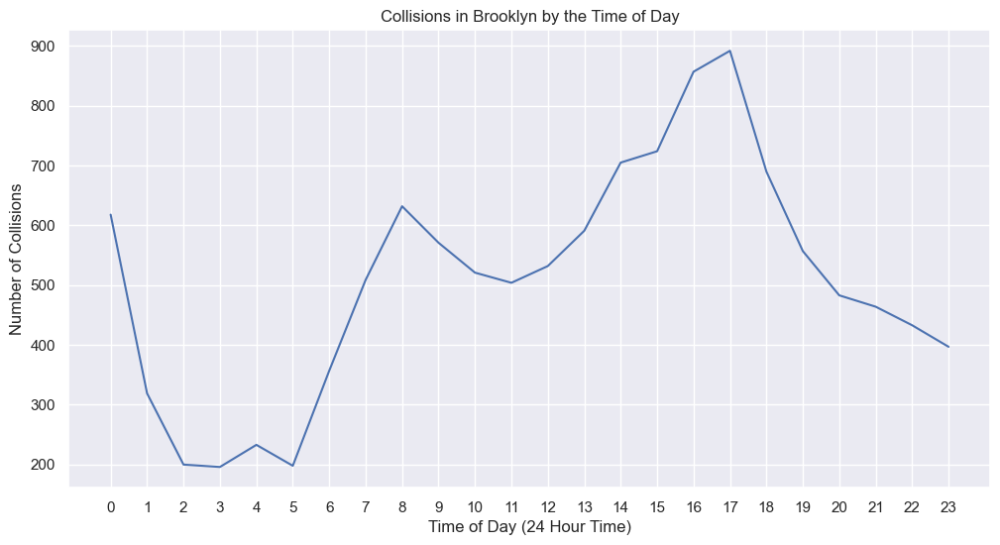

In [32]:
zipcode_11207['CRASH TIME'] = pd.to_datetime(zipcode_11207['CRASH TIME'])

collisions_by_time_11207 = zipcode_11207.groupby(zipcode_11207['CRASH TIME'].dt.hour).size()


plt.figure(figsize=(12, 6))
plt.plot(collisions_by_time_11207.index, collisions_by_time_11207.values)
plt.title('Collisions in Brooklyn by the Time of Day')
plt.xlabel('Time of Day (24 Hour Time)')
plt.ylabel('Number of Collisions')
plt.xticks(range(24))  
plt.grid(True)  
plt.show()

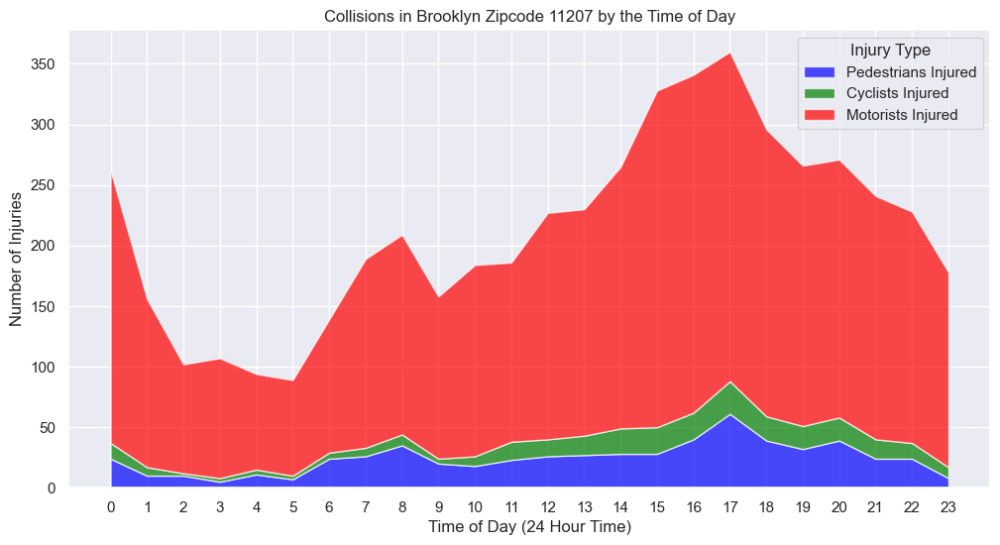

In [33]:
sns.set_theme()

zipcode_11207['CRASH TIME'] = pd.to_datetime(zipcode_11207['CRASH TIME'])

collisions_by_time = zipcode_11207.groupby(zipcode_11207['CRASH TIME'].dt.hour)[['NUMBER OF PEDESTRIANS INJURED', 
                                                                                 'NUMBER OF CYCLIST INJURED', 'NUMBER OF MOTORIST INJURED']].sum()

collisions_by_time = collisions_by_time.reset_index()

pedestrians_injured = collisions_by_time['NUMBER OF PEDESTRIANS INJURED']
cyclists_injured = collisions_by_time['NUMBER OF CYCLIST INJURED']
motorists_injured = collisions_by_time['NUMBER OF MOTORIST INJURED']

plt.figure(figsize=(12, 6))
plt.stackplot(collisions_by_time['CRASH TIME'], pedestrians_injured, cyclists_injured, motorists_injured, 
              labels=['Pedestrians Injured', 'Cyclists Injured', 'Motorists Injured'], colors=['blue', 'green', 'red'], alpha=0.7)

plt.title('Collisions in Brooklyn Zipcode 11207 by the Time of Day')
plt.xlabel('Time of Day (24 Hour Time)')
plt.ylabel('Number of Injuries')
plt.xticks(range(24))
plt.legend(title='Injury Type')
plt.grid(True)

plt.savefig('Collisions in Brooklyn Zipcode 11207 by the Time of Day.jpeg', bbox_inches='tight', pad_inches=0.5)
plt.show()

Now that we've seen the extent of the damage, can we examine some factors that may contribute to these injuries? We can get a street like view if we decide to get data like the median household income and such. With low household income, it might explain why the infastructure of the area is so bad.

In [35]:
search = SearchEngine()

def get_zipcode_info(zipcode):
    result = search.by_zipcode(zipcode)
    if result:
        return {
            'Zipcode': zipcode,
            'City': result.major_city,
            'Density': result.population_density,
            'Median Household Income': result.median_household_income,
            'Median Home Value': result.median_home_value,
            'Land Area': result.land_area_in_sqmi,
        }
    else:
        return None

zipcode_info_list = [get_zipcode_info(zipcode) for zipcode in crashes_in_brooklyn['ZIP CODE']]

zipcode_info_list = [info for info in zipcode_info_list if info is not None]

zipcode_info_df = pd.DataFrame(zipcode_info_list)


In [36]:
brooklyn_zipcode_lvl_data = zipcode_info_df.sort_values(by='Median Household Income', ascending=True)

In [37]:
brooklyn_zipcode_lvl_data

,Zipcode,City,Density,Median Household Income,Median Home Value,Land Area
23932,11239,Brooklyn,23470.0,26275.0,354600.0,0.57
146065,11239,Brooklyn,23470.0,26275.0,354600.0,0.57
67858,11239,Brooklyn,23470.0,26275.0,354600.0,0.57
145960,11239,Brooklyn,23470.0,26275.0,354600.0,0.57
145964,11239,Brooklyn,23470.0,26275.0,354600.0,0.57
...,...,...,...,...,...,...
182255,11249,Brooklyn,NaN,NaN,NaN,NaN
182278,11249,Brooklyn,NaN,NaN,NaN,NaN
182345,11249,Brooklyn,NaN,NaN,NaN,NaN
182379,11249,Brooklyn,NaN,NaN,NaN,NaN


In [38]:
brooklyn_zipcode_lvl_data.to_excel('shoot.xlsx')

In [40]:
zipcode_11207_income = brooklyn_zipcode_lvl_data[brooklyn_zipcode_lvl_data['Zipcode'] == 11207]

In [41]:
zipcode_11207_income.to_excel('kill_me.xlsx')

The zipcode 11249 seems to be missing a lot of the data. 11249 is Williamsburg, which is actually one of the wealthier zipcodes in Brooklyn, so assuming that the data was present it would most likely top the list in Brooklyn. This is supported even further as looking at the previous visuals we see that 11249 has some of least amount of collisions in the hotspot that is Brooklyn. 

However on the opposite end of the spectrum we have the problem zipcode of 11207 which actually happens to be the fourth lowest zipcode in terms of median household income. 

### Concentrating on one zipcode in NYC

How do we explain this?

In [25]:
#importing the scaling and encoding needed for modeling
scaler = StandardScaler()
label_encoder = LabelEncoder()

#Creating a separate df to make things easier
brooklyn_model_df = pd.DataFrame({'Number of People Injured': crashes_in_brooklyn['NUMBER OF PERSONS INJURED'],
                                  'Time of Crash': crashes_in_brooklyn['CRASH TIME'], 
                                  'Median Household Income': zipcode_11207_income['Median Household Income'],
                                  'Vehicle 1': crashes_in_brooklyn["CONTRIBUTING FACTOR VEHICLE 1"],
                                  'Vehicle 2': crashes_in_brooklyn["CONTRIBUTING FACTOR VEHICLE 2"],
                                  'Vehicle 3': crashes_in_brooklyn["CONTRIBUTING FACTOR VEHICLE 3"],
                                  'Vehicle 4': crashes_in_brooklyn["CONTRIBUTING FACTOR VEHICLE 4"],
                                  'Vehicle 5': crashes_in_brooklyn["CONTRIBUTING FACTOR VEHICLE 5"]
                                  })

brooklyn_model_df['Median Household Income'] = scaler.fit_transform(brooklyn_model_df[['Median Household Income']])

brooklyn_model_df.dropna(subset=['Number of People Injured'], inplace=True)

brooklyn_model_df['Time of Crash'] = pd.to_datetime(brooklyn_model_df['Time of Crash']).dt.hour + pd.to_datetime(brooklyn_model_df['Time of Crash']).dt.minute / 60.0


for col in ["Vehicle 1", "Vehicle 2", 
            "Vehicle 3", "Vehicle 4", 
            "Vehicle 5"]:
    brooklyn_model_df[col + '_present'] = brooklyn_model_df[col].notna().astype(int)

X = brooklyn_model_df[['Time of Crash'] + [col + '_present' for col in ["Vehicle 1",
                                                                 "Vehicle 2",
                                                                 "Vehicle 3",
                                                                 "Vehicle 4",
                                                                 "Vehicle 5"]]]


X['Scaled Median Household Income'] = brooklyn_model_df['Median Household Income']

imputer = SimpleImputer(strategy='median')

X_imputed = imputer.fit_transform(X)

y = brooklyn_model_df['Number of People Injured']

X.dropna(inplace=True)
y = y[X.index] 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)

print(f"Mean Squared Error: {mse}")

Mean Squared Error: 0.5057016099968228
